In [47]:
import pandas as pd
import numpy as np

#'''Seaborn and Matplotlib Visualization'''
import matplotlib                  # 2D Plotting Library
import matplotlib.pyplot as plt
import seaborn as sns              # Python Data Visualization Library based on matplotlib
plt.style.use('fivethirtyeight')
%matplotlib inline

#'''Plotly Visualizations'''
import plotly as plotly                # Interactive Graphing Library for Python
import plotly.express as px
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode, iplot, plot
import plotly.offline as py
init_notebook_mode(connected=True)
import os
%pylab inline
import re

import warnings
warnings.filterwarnings('ignore')


Populating the interactive namespace from numpy and matplotlib


In [48]:
data = pd.read_csv('CDC_CLEANED.csv')

In [49]:
data.head()

,county_code,census_tract,conforming_loan_limit,derived_loan_product_type,derived_ethnicity,derived_race,derived_sex,action_taken,purchaser_type,preapproval,...,denial_reason-2,denial_reason-3,denial_reason-4,tract_population,tract_minority_population_percent,ffiec_msa_md_median_family_income,tract_to_msa_income_percentage,tract_owner_occupied_units,tract_one_to_four_family_homes,tract_median_age_of_housing_units
0,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,NaN,NaN,NaN,7063,68.84,70700,84,2053,2733,15
1,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,NaN,NaN,NaN,7063,68.84,70700,84,2053,2733,15
2,37085.0,3.708507e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Male,3,0,2,...,NaN,NaN,NaN,4746,46.46,56500,73,1068,1969,44
3,37065.0,3.706502e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Male,4,0,2,...,NaN,NaN,NaN,3162,47.53,54700,79,761,1416,38
4,37185.0,3.718595e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Joint,1,8,2,...,NaN,NaN,NaN,4162,69.46,51600,74,920,1872,40


In [50]:
data.dropna(inplace = True, thresh = 250000, axis = 1)

In [51]:
data.shape

(594769, 43)

In [52]:
data.columns

Index(['county_code', 'census_tract', 'conforming_loan_limit',
       'derived_loan_product_type', 'derived_ethnicity', 'derived_race',
       'derived_sex', 'action_taken', 'purchaser_type', 'preapproval',
       'loan_type', 'loan_purpose', 'open-end_line_of_credit',
       'business_or_commercial_purpose', 'loan_amount', 'loan_to_value_ratio',
       'interest_rate', 'rate_spread', 'total_loan_costs',
       'origination_charges', 'loan_term', 'interest_only_payment',
       'property_value', 'occupancy_type', 'total_units', 'income',
       'debt_to_income_ratio', 'co-applicant_credit_score_type',
       'applicant_ethnicity-1', 'co-applicant_ethnicity-1', 'applicant_race-1',
       'co-applicant_race-1', 'applicant_age', 'co-applicant_age',
       'applicant_age_above_62', 'denial_reason-1', 'tract_population',
       'tract_minority_population_percent',
       'ffiec_msa_md_median_family_income', 'tract_to_msa_income_percentage',
       'tract_owner_occupied_units', 'tract_one_to

In [53]:
data.drop(['open-end_line_of_credit', 'rate_spread', 'total_loan_costs', 'origination_charges',
        'loan_term', 'interest_only_payment',
       'co-applicant_credit_score_type',
       'applicant_ethnicity-1', 'co-applicant_ethnicity-1', 'applicant_race-1',
       'co-applicant_race-1', 'co-applicant_age','applicant_age_above_62'], inplace = True, axis =1)

In [54]:
data.head()

,county_code,census_tract,conforming_loan_limit,derived_loan_product_type,derived_ethnicity,derived_race,derived_sex,action_taken,purchaser_type,preapproval,...,debt_to_income_ratio,applicant_age,denial_reason-1,tract_population,tract_minority_population_percent,ffiec_msa_md_median_family_income,tract_to_msa_income_percentage,tract_owner_occupied_units,tract_one_to_four_family_homes,tract_median_age_of_housing_units
0,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,20%-<30%,55-64,10,7063,68.84,70700,84,2053,2733,15
1,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,20%-<30%,55-64,10,7063,68.84,70700,84,2053,2733,15
2,37085.0,3.708507e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Male,3,0,2,...,20%-<30%,55-64,7,4746,46.46,56500,73,1068,1969,44
3,37065.0,3.706502e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Male,4,0,2,...,NaN,25-34,10,3162,47.53,54700,79,761,1416,38
4,37185.0,3.718595e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Joint,1,8,2,...,38,45-54,10,4162,69.46,51600,74,920,1872,40


In [55]:
import seaborn as sns
import matplotlib.pyplot as plt

In [56]:
data.dtypes

county_code                          float64
census_tract                         float64
conforming_loan_limit                 object
derived_loan_product_type             object
derived_ethnicity                     object
derived_race                          object
derived_sex                           object
action_taken                           int64
purchaser_type                         int64
preapproval                            int64
loan_type                              int64
loan_purpose                           int64
business_or_commercial_purpose         int64
loan_amount                          float64
loan_to_value_ratio                   object
interest_rate                         object
property_value                        object
occupancy_type                         int64
total_units                            int64
income                               float64
debt_to_income_ratio                  object
applicant_age                         object
denial_rea

In [12]:
data.head()

,county_code,census_tract,conforming_loan_limit,derived_loan_product_type,derived_ethnicity,derived_race,derived_sex,action_taken,purchaser_type,preapproval,...,total_units,income,debt_to_income_ratio,applicant_age,denial_reason-1,tract_population,tract_minority_population_percent,ffiec_msa_md_median_family_income,tract_to_msa_income_percentage,tract_median_age_of_housing_units
0,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,1,51.0,20%-<30%,55-64,10,7063,68.84,70700,84,15
1,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,1,51.0,20%-<30%,55-64,10,7063,68.84,70700,84,15
2,37085.0,3.708507e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Male,3,0,2,...,1,36.0,20%-<30%,55-64,7,4746,46.46,56500,73,44
3,37065.0,3.706502e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Male,4,0,2,...,1,39.0,NaN,25-34,10,3162,47.53,54700,79,38
4,37185.0,3.718595e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Joint,1,8,2,...,1,92.0,38,45-54,10,4162,69.46,51600,74,40


In [57]:
data.drop(['tract_owner_occupied_units', 'tract_one_to_four_family_homes']
          , axis =1, inplace = True)

In [58]:
data['county_code'].astype('str')


0         37119.0
1         37119.0
2         37085.0
3         37065.0
4         37185.0
           ...   
594764    37159.0
594765    37119.0
594766    37179.0
594767    37025.0
594768    37049.0
Name: county_code, Length: 594769, dtype: object

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]), <a list of 9 Text xticklabel objects>)

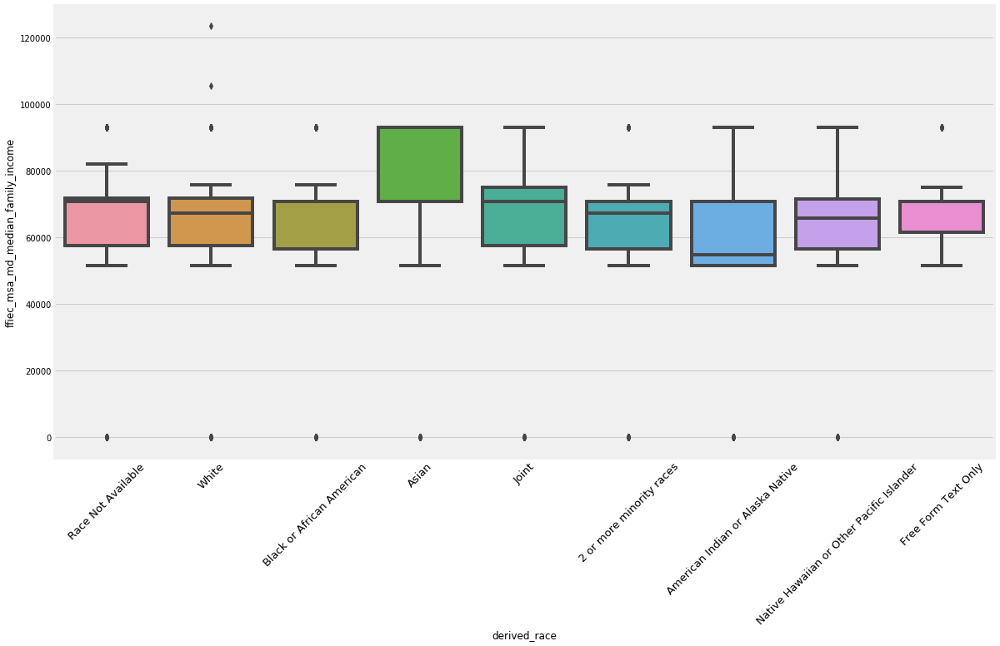

In [59]:
#SeaBorn BoxPlot: Race vs. Median Family Income

plt.rcParams['figure.figsize'] = (18,10)
sns.boxplot(x = 'derived_race', y = 'ffiec_msa_md_median_family_income', data = data)
plt.xticks(rotation = 45, size = 13)

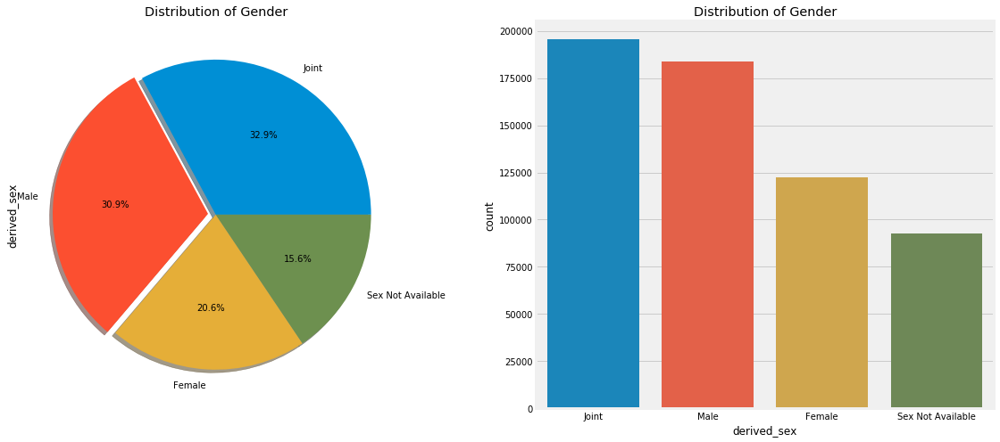

In [60]:
#Seaborn: Age Distribution

f,ax=plt.subplots(1,2,figsize=(18,8))

data['derived_sex'].value_counts().plot.pie(explode=[0,0.05,0,0],autopct='%1.1f%%',ax=ax[0],shadow=True)
ax[0].set_title('Distribution of Gender')

sns.countplot('derived_sex',data=data,ax=ax[1])
ax[1].set_title('Distribution of Gender')
plt.show()

In [61]:
#Plotly Derived Race Distributions

labels = sorted(data.derived_race.unique())
values = data.derived_race.value_counts().sort_index()
colors = ['DarkGrey', 'HotPink']


fig = go.Figure(data=[go.Pie(labels=labels,
                             values=values, pull=[0, 0.06])])
fig.update_traces(hoverinfo='label+percent', textinfo='value',textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))

fig.update_layout(title_text="Distribution of Derived Race")
fig.show()

In [62]:
#Plotly: Derived Ethnicity Distribution

labels = sorted(data.derived_ethnicity.unique())
values = data.derived_ethnicity.value_counts().sort_index()
colors = ['DarkGrey', 'HotPink']


fig = go.Figure(data=[go.Pie(labels=labels,
                             values=values, pull=[0, 0.06])])
fig.update_traces(hoverinfo='label+percent', textinfo='value',textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))

fig.update_layout(title_text="Distribution of Derived Ethnicity")
fig.show()

In [63]:
#Plotly: Conforming Loan Limit - Gender

ccl_c = data[data['conforming_loan_limit'] == 'C']
ccl_nc = data[data['conforming_loan_limit'] == 'NC']
ccl_u = data[data['conforming_loan_limit'] == 'U']

trace1 = go.Histogram(
    x=ccl_c.derived_sex,
    opacity=0.85,
    name = "Conforming",
    marker=dict(color='LightSeaGreen',line=dict(color='#000000', width=2)))
trace2 = go.Histogram(
    x=ccl_nc.derived_sex,
    opacity=0.85,
    name = "Not Conforming",
    marker=dict(color='Crimson',line=dict(color='#000000', width=2)))
trace3 = go.Histogram(
    x=ccl_u.derived_sex,
    opacity=0.85,
    name = "Not Survived",
    marker=dict(color='Coral',line=dict(color='#000000', width=2)))

data = [trace1, trace2, trace3]
layout = go.Layout(barmode='stack',
                   title='Conforming Loan Limit - GENDER',
                   xaxis=dict(title='GENDER'),
                   yaxis=dict( title='COUNT'),
                   template = 'plotly_dark'
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [44]:
#Plotly: Conforming Loan Limit - Derived Race

trace1 = go.Histogram(
    x=ccl_c.derived_race,
    opacity=0.85,
    name = "Conforming",
    marker=dict(color='DodgerBlue',line=dict(color='#000000', width=2)))
trace2 = go.Histogram(
    x=ccl_nc.derived_race,
    opacity=0.85,
    name = "Not Conforming",
    marker=dict(color='Crimson',line=dict(color='#000000', width=2)))
trace3 = go.Histogram(
    x=ccl_u.derived_race,
    opacity=0.85,
    name = "Not Survived",
    marker=dict(color='Coral',line=dict(color='#000000', width=2)))



data = [trace1, trace2, trace3]
layout = go.Layout(barmode='stack',
                   title='Conforming Loan Limit - RACE',
                   xaxis=dict(title='RACE'),
                   yaxis=dict( title='COUNT'),
                   template = 'plotly_dark'
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [29]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.compose import make_column_selector as selector



numeric_features = ['income','loan_amount', 'tract_minority_population_percent']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

categorical_features = ['derived_sex', 'derived_race', 'derived_ethnicity', 'loan_type','county_code']
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))])

#preprocessor1 = ColumnTransformer(transformers=[
    #('num', numeric_transformer, selector(dtype_exclude="category")),
    #('cat', categorical_transformer, selector(dtype_include="category")),
    #])


In [30]:
categorical_transformer.fit_transform(data)

TypeError: argument must be a string or number